In [13]:
import sys
import os

# Agrega el directorio padre (la raíz del proyecto) al sys.path
sys.path.append(os.path.abspath('..'))

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import scipy.io as sio
from scipy.spatial import Delaunay, distance_matrix
import pandas as pd

# Importar DataLoader del proyecto.
from data.dataloader import DataLoader

In [14]:
# Tamaño objetivo para redimensionar las imágenes
obj_resize = (256, 256)

def load_img_and_keypoints_from_row(row):
    """
    Carga la imagen y sus keypoints a partir de una fila del dataframe.
    Se espera que row tenga las claves 'img' y 'mat' con las rutas a los archivos.
    """
    img_path = row['img']
    mat_path = row['mat']
    
    # Cargar la imagen
    img = Image.open(img_path)
    # Cargar el archivo .mat que contiene los keypoints
    mat_data = sio.loadmat(mat_path)
    kpts = np.array(mat_data['pts_coord'])  # Se espera shape (2, N)
    
    # Determinar el tamaño original de la imagen
    orig_size = img.size  # (ancho, alto)
    
    # Escalar los keypoints al nuevo tamaño
    kpts[0] = kpts[0] * obj_resize[0] / orig_size[0]
    kpts[1] = kpts[1] * obj_resize[1] / orig_size[1]
    
    # Redimensionar la imagen
    img_resized = img.resize(obj_resize, resample=Image.BILINEAR)
    
    return img_resized, kpts

In [15]:
def delaunay_graph(kpts):
    """
    Construye un grafo usando Delaunay triangulation.
    
    Parámetros:
        - kpts: np.array de shape (2, N) con las coordenadas de los keypoints.
    
    Devuelve:
        - edges: Lista de tuplas (i, j) representando las aristas del grafo.
    """
    pts = kpts.T  # Convertir a shape (N, 2)
    tri = Delaunay(pts)
    edges = set()
    for simplex in tri.simplices:
        # Conectar cada uno de los 3 vértices entre sí.
        for i in range(3):
            j = (i + 1) % 3
            edge = tuple(sorted((simplex[i], simplex[j])))
            edges.add(edge)
    return list(edges)

def knn_graph(kpts, k):
    """
    Construye un grafo usando k-Nearest Neighbors.
    
    Parámetros:
        - kpts: np.array de shape (2, N) con las coordenadas de los keypoints.
        - k: número de vecinos a conectar.
    
    Devuelve:
        - edges: Lista de tuplas (i, j) representando las conexiones entre keypoints.
    """
    pts = kpts.T
    dist_mat = distance_matrix(pts, pts)
    np.fill_diagonal(dist_mat, np.inf)  # Excluir la distancia del punto consigo mismo
    edges = set()
    for i in range(len(pts)):
        knn_indices = np.argsort(dist_mat[i])[:k]
        for j in knn_indices:
            edge = tuple(sorted((i, j)))
            edges.add(edge)
    return list(edges)

In [16]:
def plot_image_with_graph(ax, img, kpts, edges, title=""):
    """
    Dibuja en el eje indicado la imagen con keypoints y el grafo sobrepuesto.
    
    Parámetros:
        - ax: objeto matplotlib.axes donde se dibuja.
        - img: imagen a mostrar.
        - kpts: array de keypoints (2, N).
        - edges: lista de tuplas (i, j) con las conexiones del grafo.
        - title: título para la subfigura.
    """
    ax.imshow(img)
    ax.scatter(kpts[0], kpts[1], c='w', edgecolors='k')
    for i, j in edges:
        ax.plot([kpts[0, i], kpts[0, j]], [kpts[1, i], kpts[1, j]], 'r-')
    ax.set_title(title)
    ax.axis('off')

In [17]:
# Instanciar el DataLoader y cargar los dataframes
dl = DataLoader()
dfs = dl.load_data()

# Lista de categorías a procesar
categories = ['car', 'face', 'duck', 'motorbike', 'winebottle']


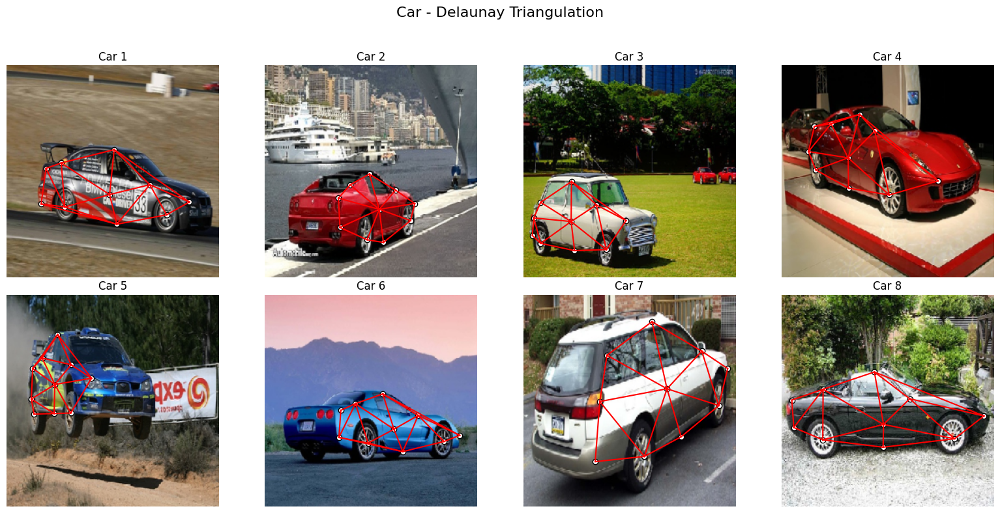

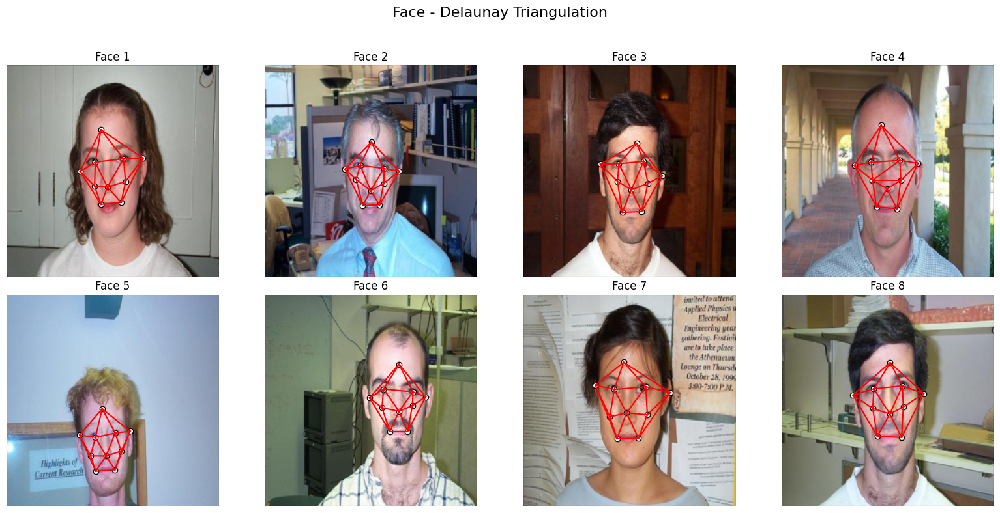

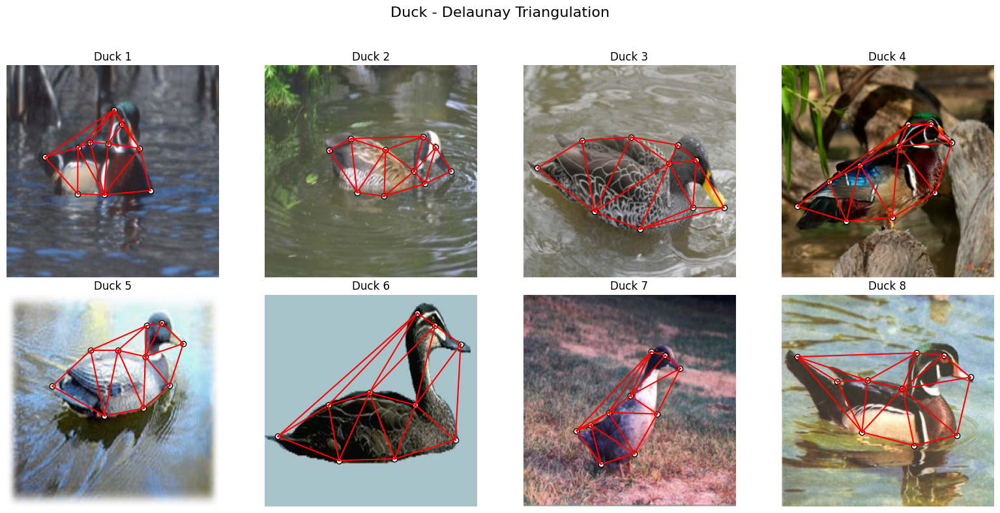

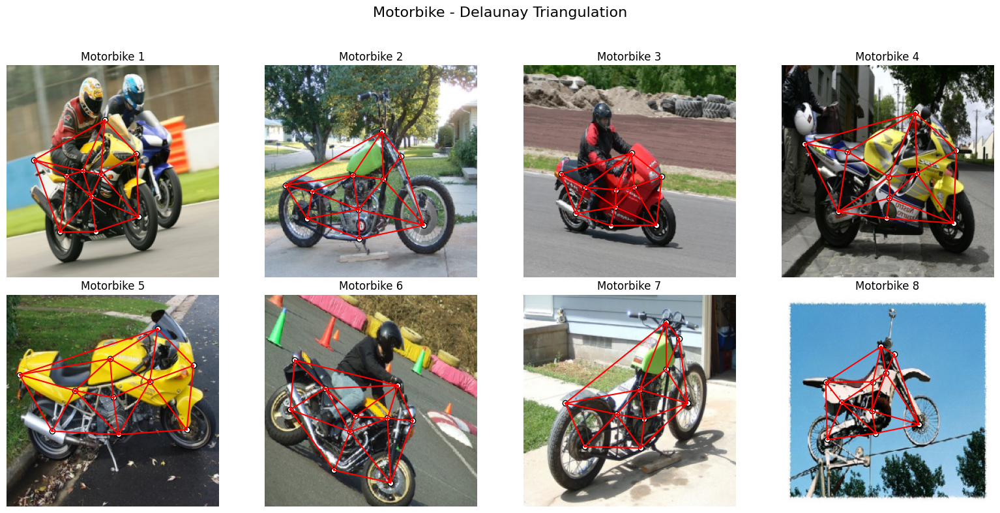

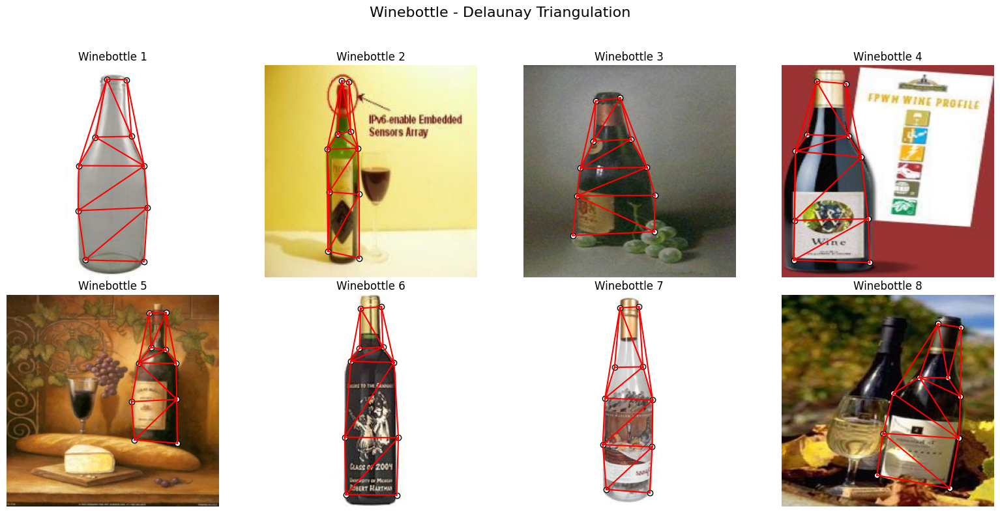

In [18]:
# Ejercicio 1: Delaunay Triangulation
# Para cada categoría se seleccionan 8 imágenes y se muestran en un grid 2x4.

for cat in categories:
    key = f"{cat}_df"
    df_cat = dfs.get(key)
    if df_cat is None or df_cat.empty:
        print(f"No se encontró información para la categoría: {cat}")
        continue
    
    # Seleccionar 8 imágenes
    sample_rows = df_cat.sample(8) if len(df_cat) >= 8 else df_cat
    
    # Crear grid 2x4
    ncols = 4
    nrows = (len(sample_rows) + ncols - 1) // ncols
    fig, axs = plt.subplots(nrows, ncols, figsize=(16, 8))
    axs = axs.flatten()
    
    for i, (_, row) in enumerate(sample_rows.iterrows()):
        img, kpts = load_img_and_keypoints_from_row(row)
        edges = delaunay_graph(kpts)
        plot_image_with_graph(axs[i], img, kpts, edges, title=f"{cat.capitalize()} {i+1}")
    
    # Apagar ejes sobrantes en caso de haberlos
    for ax in axs[len(sample_rows):]:
        ax.axis('off')
    
    fig.suptitle(f"{cat.capitalize()} - Delaunay Triangulation", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

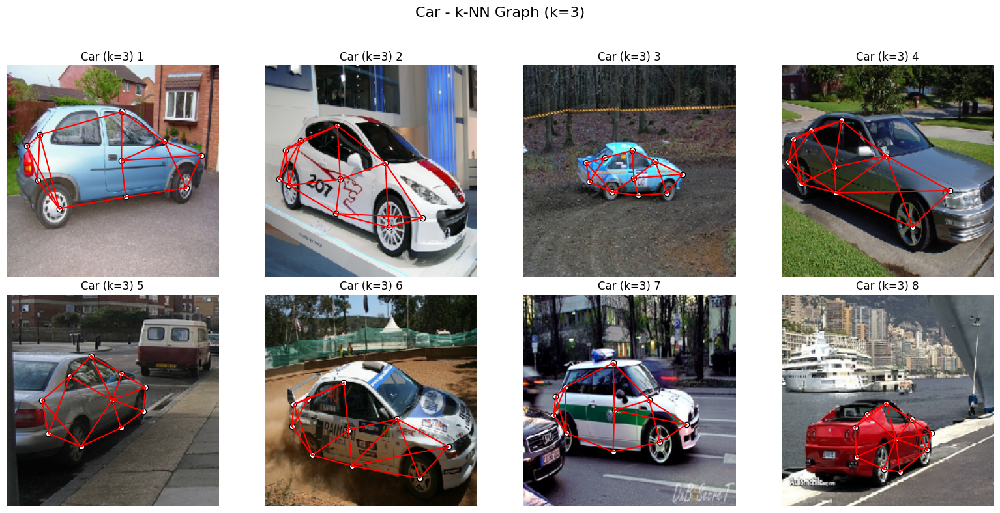

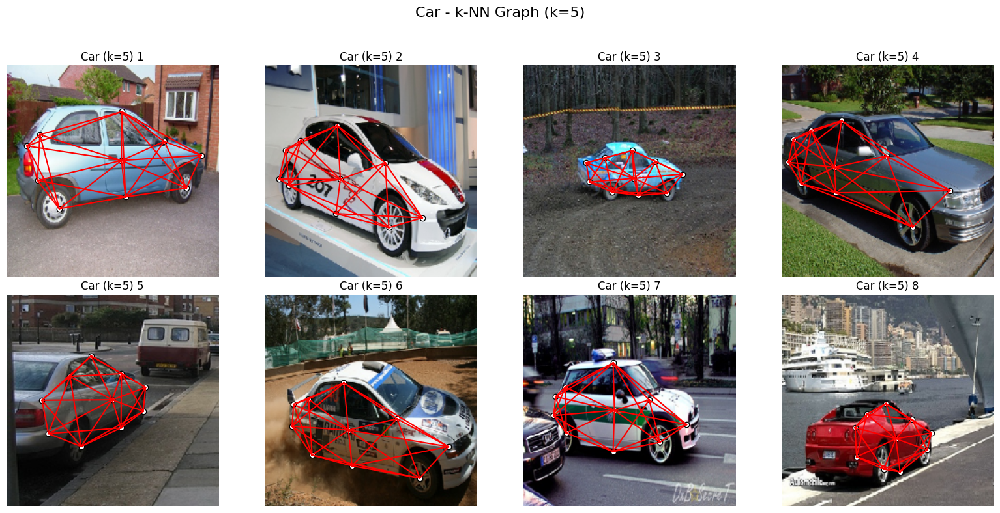

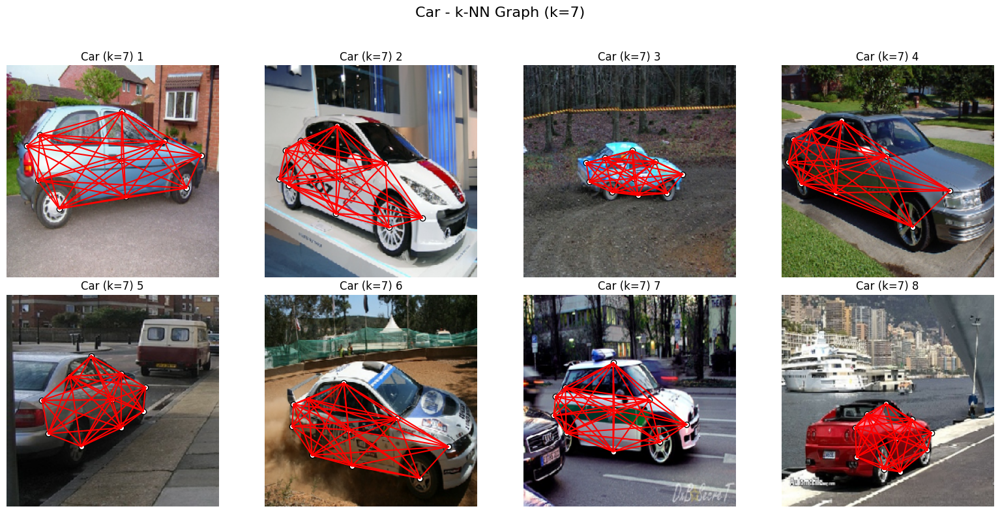

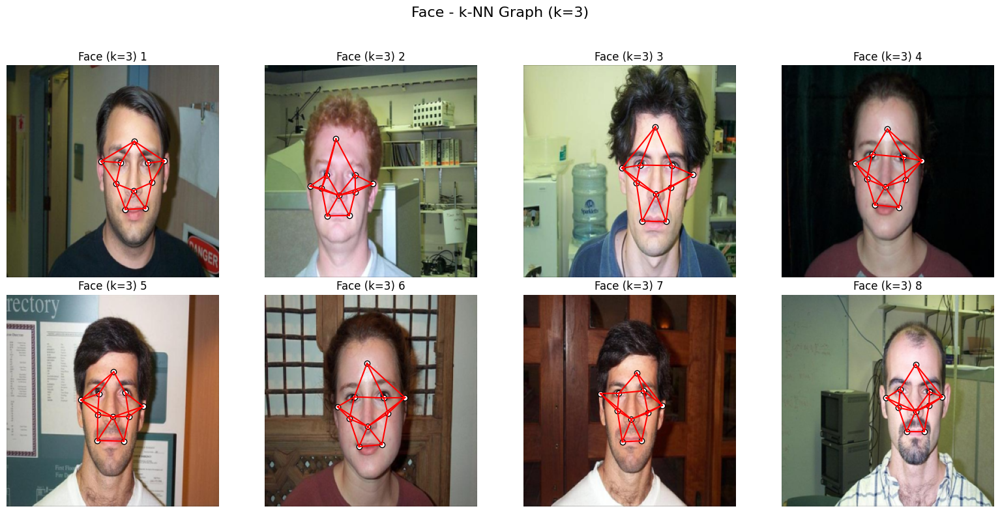

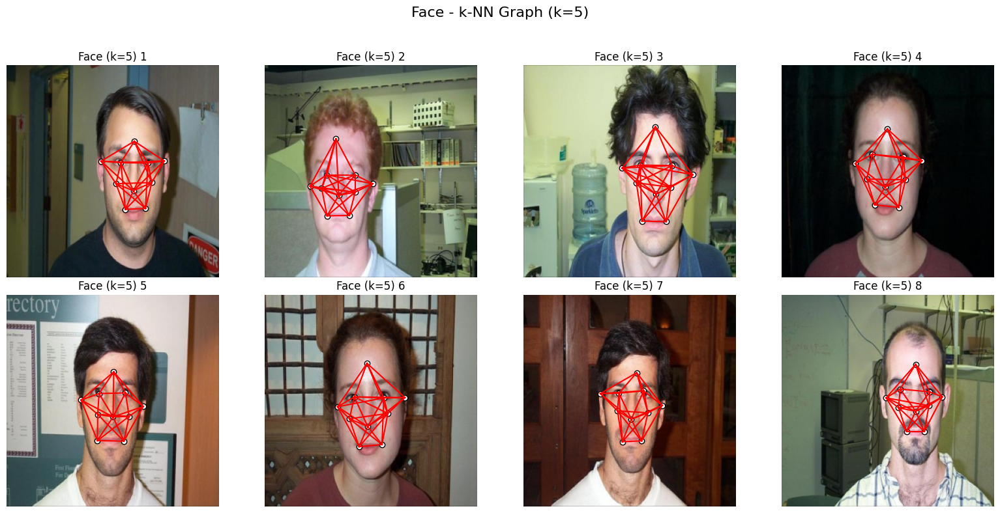

...

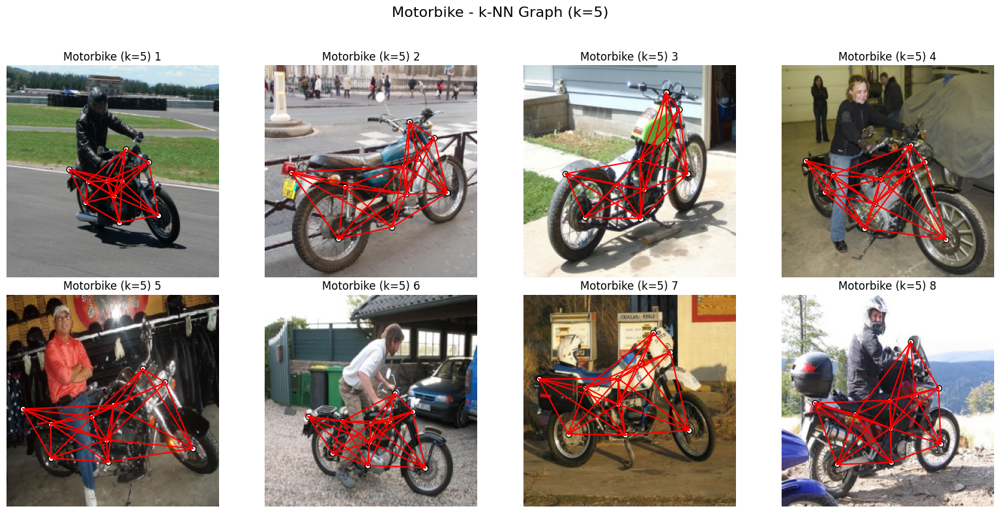

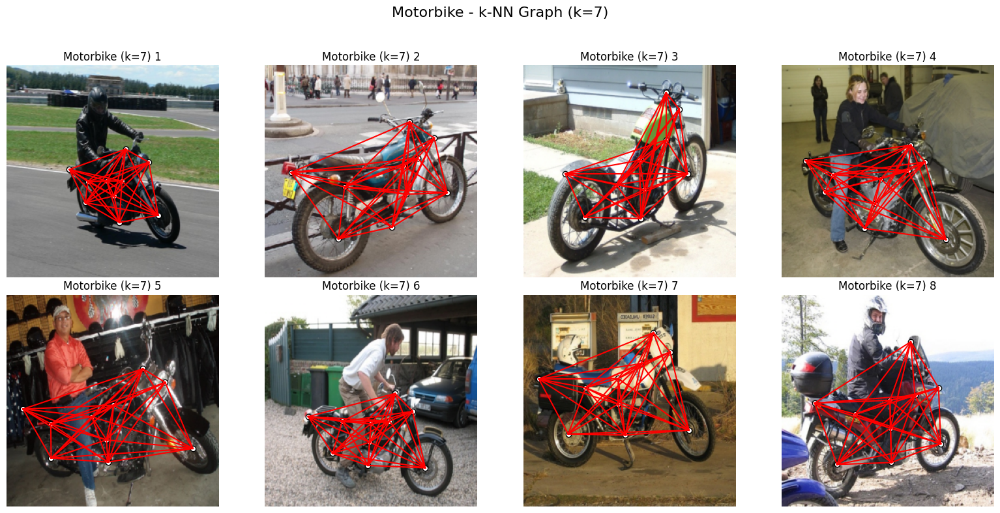

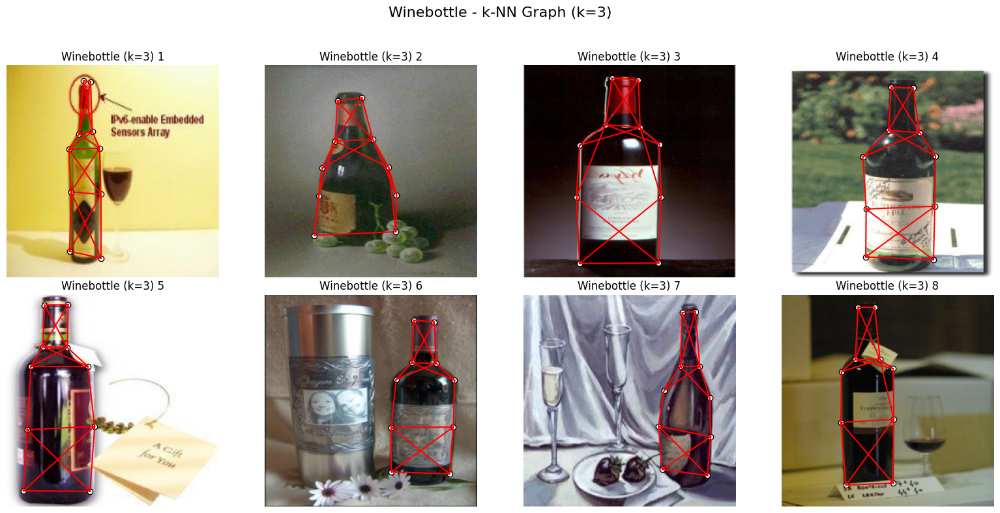

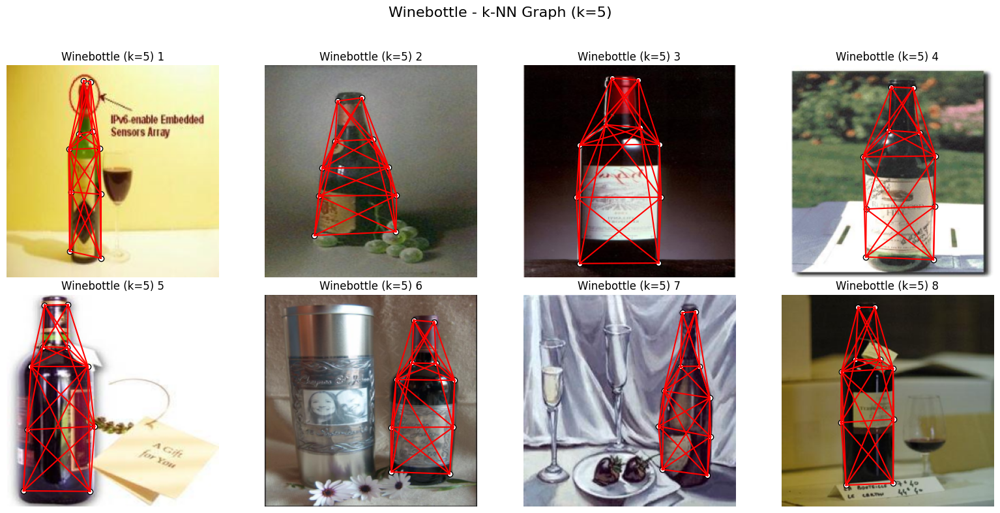

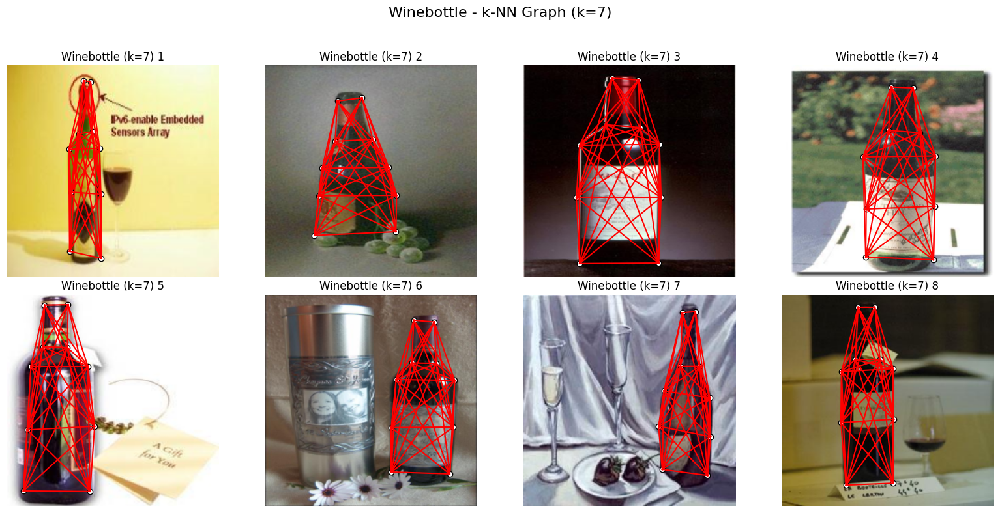

In [19]:
# Ejercicio 2: k-Nearest Neighbors (k-NN)
# Para cada categoría y para cada valor de k (3, 5, 7), se muestra un grid 2x4.

ks = [3, 5, 7]

for cat in categories:
    key = f"{cat}_df"
    df_cat = dfs.get(key)
    if df_cat is None or df_cat.empty:
        print(f"No se encontró información para la categoría: {cat}")
        continue
    
    # Seleccionar 8 imágenes
    sample_rows = df_cat.sample(8) if len(df_cat) >= 8 else df_cat
    
    for k in ks:
        ncols = 4
        nrows = (len(sample_rows) + ncols - 1) // ncols
        fig, axs = plt.subplots(nrows, ncols, figsize=(16, 8))
        axs = axs.flatten()
        
        for i, (_, row) in enumerate(sample_rows.iterrows()):
            img, kpts = load_img_and_keypoints_from_row(row)
            edges = knn_graph(kpts, k)
            plot_image_with_graph(axs[i], img, kpts, edges, title=f"{cat.capitalize()} (k={k}) {i+1}")
        
        for ax in axs[len(sample_rows):]:
            ax.axis('off')
        
        fig.suptitle(f"{cat.capitalize()} - k-NN Graph (k={k})", fontsize=16)
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()